# Prerequisites

In [1]:
import numpy as np
import pandas as pd
import scanpy.api as sc
import seaborn as sb
import matplotlib.pyplot as plt
import scrublet as scr
import MulticoreTSNE
import os
import glob
from matplotlib import colors
from matplotlib import rcParams
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline

sc.settings.set_figure_params(dpi=200)
sc.logging.print_versions()

/home/icb/subarna.palit/tmp/anaconda3/lib/python3.7/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning


scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.16.4 scipy==1.3.0 pandas==0.24.2 scikit-learn==0.21.2 statsmodels==0.10.0 python-igraph==0.7.1 louvain==0.6.1


# Load raw data

In [2]:
# Read cellranger filtered file for hair cells sample
ad_hair = sc.read("./filtered_gene_bc_matrices.h5ad", cache=True)
ad_hair # Zebrafish hair cells with 2641 cells

AnnData object with n_obs × n_vars = 2641 × 27599 

# Doublet score calculations using Scrublet

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.50
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 36.1%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 2.5%
Elapsed time: 12.0 seconds


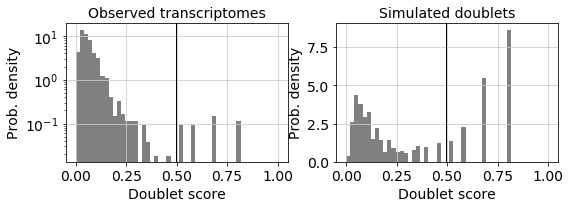

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/umap/umap_.py:349: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../../../anaconda3/lib/python3.6/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is None or knn_dists is None:
        knn_indices, knn_dists, _ = nearest_neighbors(
        ^

  @numba.jit()
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/numba/compiler.py:725: NumbaWarning: Function "fuzzy_simplicial_set" was compiled in object mode without forceobj=True.

File "../../../../anaconda3/lib/python3.6/site-packages/umap/umap_.py", line 350:
@numba.jit()
def fuzzy_simplicial_set(
^

  self.func_ir.loc))
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/numba/compiler.py:734: Num

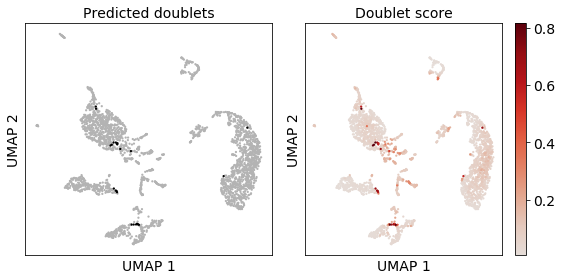

In [3]:
scrub = scr.Scrublet(ad_hair.X)
doublet_scores, predicted_doublets = scrub.scrub_doublets()
# scrub.call_doublets(threshold=0.45)
scrub.plot_histogram()
plt.show()
scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.4))
scrub.plot_embedding('UMAP', order_points=True);
plt.show()

In [4]:
adata_s = sc.AnnData(ad_hair.X[doublet_scores < 0.50,:])
adata_s.obs = ad_hair.obs[doublet_scores < 0.50]
adata_s.var = ad_hair.var.copy()
ad_hair = adata_s.copy()
del adata_s
ad_hair # 2617 cells remaining after doublet correction, we use standard pipeline starting from the raw data to calculate doublet scores

AnnData object with n_obs × n_vars = 2617 × 27599 

# Preprocessing
# Quality Control

In [5]:
# Calculating QC metrics
ad_hair.obs['n_counts'] = ad_hair.X.sum(axis=1)
ad_hair.obs['log_counts'] = np.log(ad_hair.obs['n_counts'])

ad_hair.obs['n_genes'] = (ad_hair.X > 0).sum(1)
# Calculate percentage of mitochondrial genes expressed in each cell
mito_genes = [name for name in ad_hair.var_names if name.startswith('mt-')]
ad_hair.obs['mt_frac'] = np.sum(ad_hair[:, mito_genes].X, axis=1) / np.sum(ad_hair.X, axis=1)

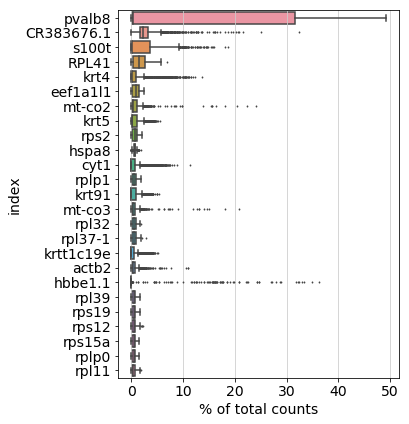

(2617, 27599)

In [6]:
ad_hair.var_names_make_unique()
sc.pl.highest_expr_genes(ad_hair, n_top=25)
ad_hair.shape

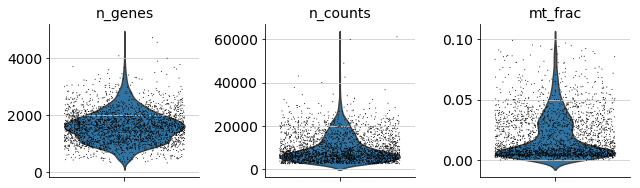

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


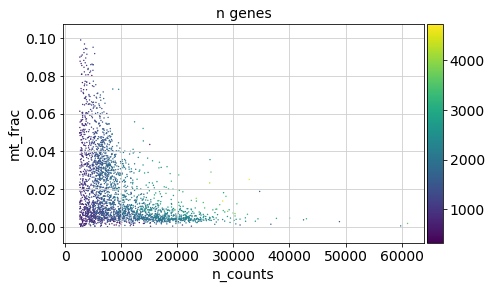

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


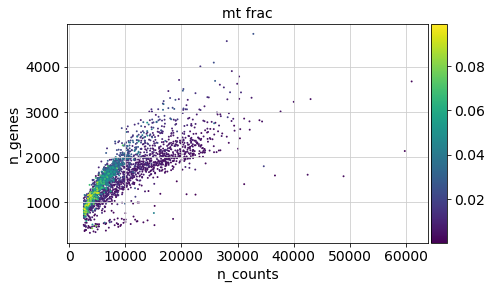

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


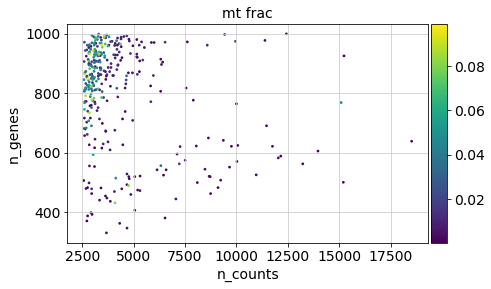

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


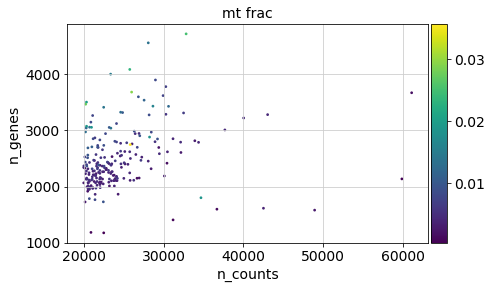

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


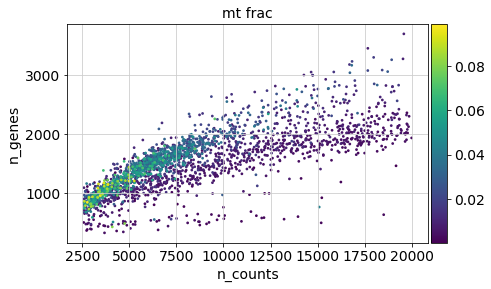

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  alternative="'density'", removal="3.1")


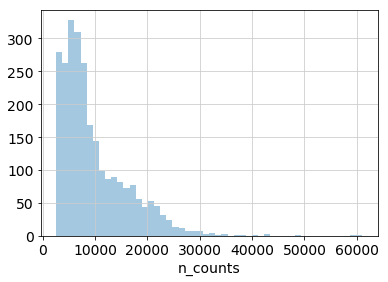

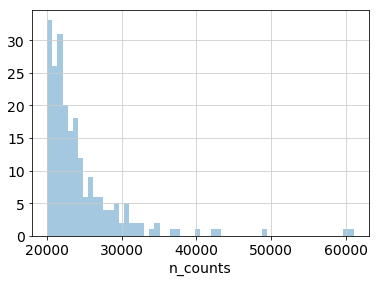

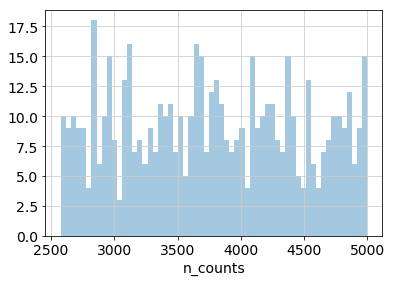

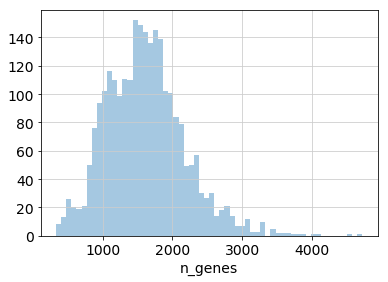

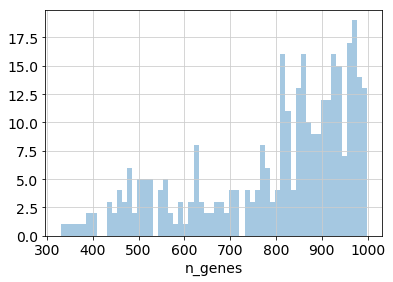

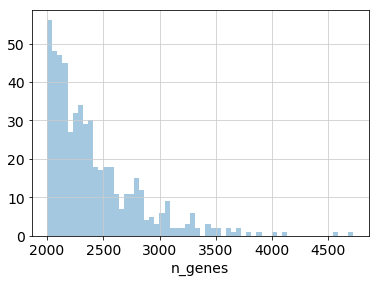

In [9]:
sc.pl.violin(ad_hair, ['n_genes', 'n_counts', 'mt_frac'], jitter=0.4, multi_panel=True)
sc.pl.scatter(ad_hair, x='n_counts', y='mt_frac', color = 'n_genes', size = 8)

sc.pl.scatter(ad_hair, 'n_counts', 'n_genes', color='mt_frac', size=15)
sc.pl.scatter(ad_hair[ad_hair.obs['n_genes']<1000], 'n_counts', 'n_genes', color='mt_frac',size=30)
sc.pl.scatter(ad_hair[ad_hair.obs['n_counts']>20000], 'n_counts', 'n_genes', color='mt_frac', size = 30)
sc.pl.scatter(ad_hair[ad_hair.obs['n_counts']<20000], 'n_counts', 'n_genes', color='mt_frac', size = 30)

p1 = sb.distplot(ad_hair.obs['n_counts'], kde=False)
plt.show()
p2 = sb.distplot(ad_hair.obs['n_counts'][ad_hair.obs['n_counts']>20000], kde=False, bins=60)
plt.show()
p6 = sb.distplot(ad_hair.obs['n_counts'][ad_hair.obs['n_counts']<5000], kde=False, bins=60)
plt.show()

p3 = sb.distplot(ad_hair.obs['n_genes'], kde=False, bins=60)
plt.show()
p4 = sb.distplot(ad_hair.obs['n_genes'][ad_hair.obs['n_genes']<1000], kde=False, bins=60)
plt.show()
p5 = sb.distplot(ad_hair.obs['n_genes'][ad_hair.obs['n_genes']>2000], kde=False, bins=60)
plt.show()

In [10]:
# Filtering cells based on defined thresholds
ad_hair = ad_hair[ad_hair.obs['mt_frac'] < 0.1, :]

sc.pp.filter_cells(ad_hair, max_counts = 30000)
print('Number of cells after max count filter: {:d}'.format(ad_hair.n_obs))

sc.pp.filter_cells(ad_hair, min_genes = 800)
print('Number of cells after gene filter: {:d}'.format(ad_hair.n_obs))

sc.pp.filter_cells(ad_hair, max_genes=3500)
print('Number of cells after gene filter: {:d}'.format(ad_hair.n_obs))

ad_hair.shape # 2421 cells left after thresholding decisions

Number of cells after max count filter: 2553
Number of cells after gene filter: 2431
Number of cells after gene filter: 2421


(2421, 27599)

In [11]:
# Adding label for each sample
ad_hair.obs['sample']='10x_hair'

# Load raw data

In [13]:
# Read cellranger filtered file for support cells sample
ad_supp = sc.read('./filtered_gene_bc_matrices.h5ad', cache=True)
ad_supp # Zebrafish support cells with 8505 cells

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/readwrite/read.py:440: DeprecationWarning: In a future version, read_h5ad will no longer explicitly support boolean arguments. Specify the read mode, or leave `backed=None`.
  DeprecationWarning,


AnnData object with n_obs × n_vars = 8505 × 27599 

# Doublet score calculations using Scrublet

Preprocessing...


/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scrublet/helper_functions.py:239: RuntimeWarning: invalid value encountered in log
  gLog = lambda input: np.log(input[1] * np.exp(-input[0]) + input[2])


Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.42
Detected doublet rate = 1.9%
Estimated detectable doublet fraction = 31.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 6.0%
Elapsed time: 20.6 seconds


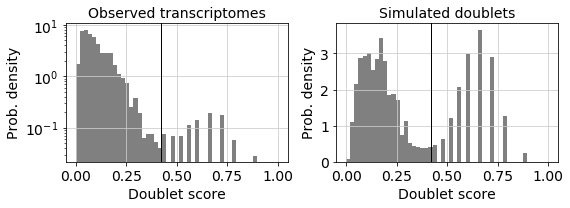

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py (457)

File "../../../../anaconda3/lib/python3.6/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee type: recursive(type(CPUDispatcher(<function ma

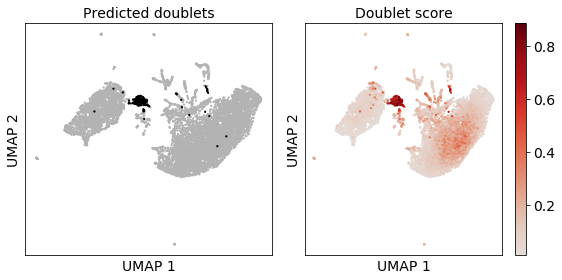

In [14]:
scrub = scr.Scrublet(ad_supp.X)
doublet_scores, predicted_doublets = scrub.scrub_doublets()
# scrub.call_doublets(threshold=0.45)
scrub.plot_histogram()
plt.show()
scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.4))
scrub.plot_embedding('UMAP', order_points=True);
plt.show()

In [15]:
adata_s = sc.AnnData(ad_supp.X[doublet_scores < 0.42,:])
adata_s.obs = ad_supp.obs[doublet_scores < 0.42]
adata_s.var = ad_supp.var.copy()
ad_supp = adata_s.copy()
del adata_s
ad_supp # 8344 cells remaining after doublet correction

AnnData object with n_obs × n_vars = 8344 × 27599 

# Preprocessing
# Quality Control

In [16]:
# Calculating QC metrics
ad_supp.obs['n_counts'] = ad_supp.X.sum(axis=1)
ad_supp.obs['log_counts'] = np.log(ad_supp.obs['n_counts'])

ad_supp.obs['n_genes'] = (ad_supp.X > 0).sum(1)
# Calculate percentage of mitochondrial genes expressed in each cell
mito_genes = [name for name in ad_supp.var_names if name.startswith('mt-')]
ad_supp.obs['mt_frac'] = np.sum(ad_supp[:, mito_genes].X, axis=1) / np.sum(ad_supp.X, axis=1)
mito_genes

['mt-nd1',
 'mt-nd2',
 'mt-co1',
 'mt-co2',
 'mt-atp8',
 'mt-atp6',
 'mt-co3',
 'mt-nd3',
 'mt-nd4l',
 'mt-nd4',
 'mt-nd5',
 'mt-nd6',
 'mt-cyb']

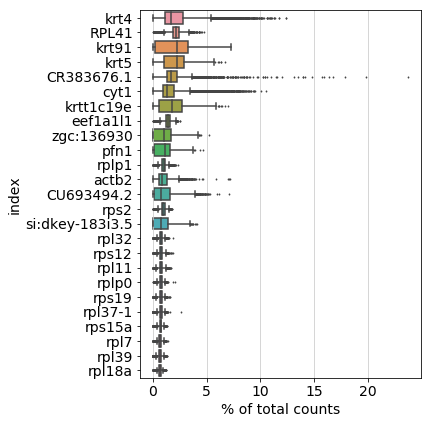

(8344, 27599)

In [17]:
ad_supp.var_names_make_unique() # making the gene names unique
sc.pl.highest_expr_genes(ad_supp, n_top=25) # calculate fraction of counts for each gene in each cell across all cells
ad_supp.shape

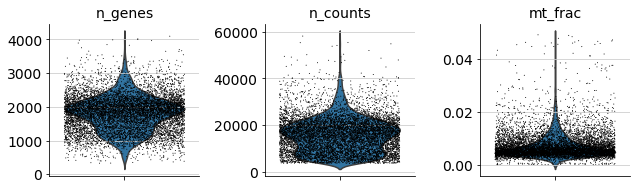

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


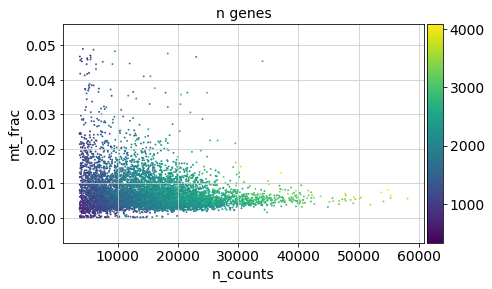

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


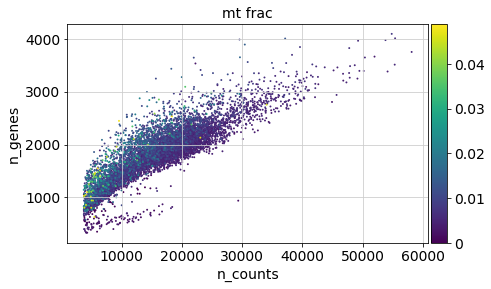

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


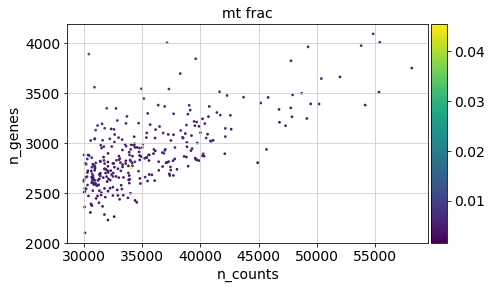

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


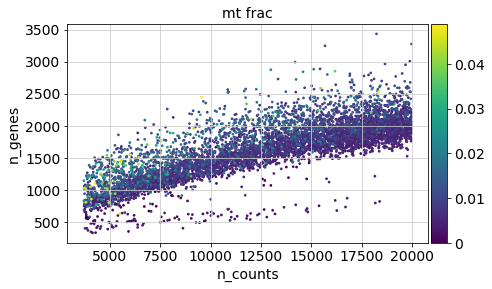

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


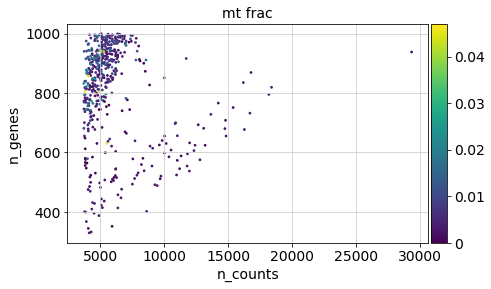

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  alternative="'density'", removal="3.1")


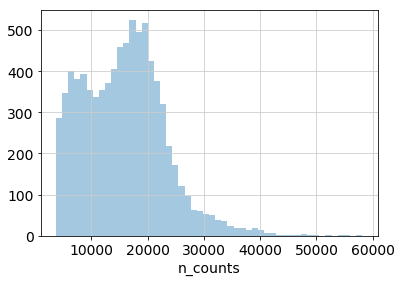

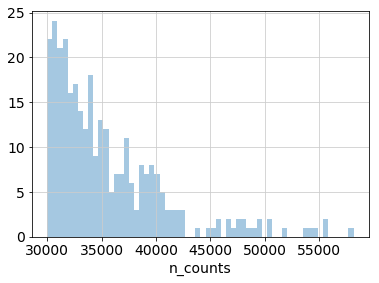

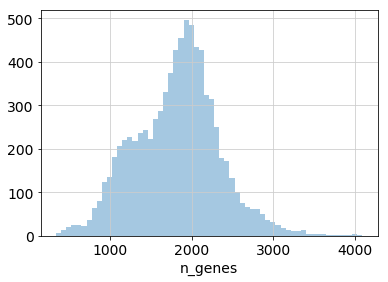

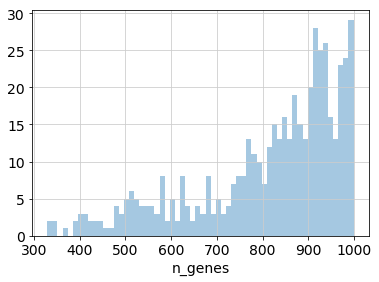

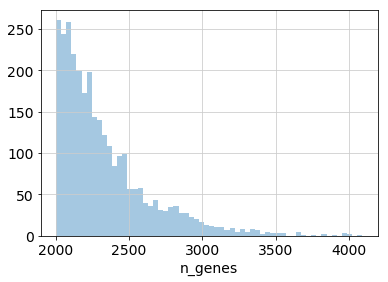

In [22]:
sc.pl.violin(ad_supp, ['n_genes', 'n_counts', 'mt_frac'], jitter=0.4, multi_panel=True)
sc.pl.scatter(ad_supp, x='n_counts', y='mt_frac', color = 'n_genes')

sc.pl.scatter(ad_supp, 'n_counts', 'n_genes', color='mt_frac', size=15)
sc.pl.scatter(ad_supp[ad_supp.obs['n_counts']>30000], 'n_counts', 'n_genes', color='mt_frac', size = 30)
sc.pl.scatter(ad_supp[ad_supp.obs['n_counts']<20000], 'n_counts', 'n_genes', color='mt_frac', size = 30)
sc.pl.scatter(ad_supp[ad_supp.obs['n_genes']<1000], 'n_counts', 'n_genes', color='mt_frac',size=30)

p1 = sb.distplot(ad_supp.obs['n_counts'], kde=False)
plt.show()
p2 = sb.distplot(ad_supp.obs['n_counts'][ad_supp.obs['n_counts']>30000], kde=False, bins=60)
plt.show()

p3 = sb.distplot(ad_supp.obs['n_genes'], kde=False, bins=60)
plt.show()
p4 = sb.distplot(ad_supp.obs['n_genes'][ad_supp.obs['n_genes']<1000], kde=False, bins=60)
plt.show()
p5 = sb.distplot(ad_supp.obs['n_genes'][ad_supp.obs['n_genes']>2000], kde=False, bins=60)
plt.show()

In [23]:
# Filtering cells based on defined thresholds
ad_supp = ad_supp[ad_supp.obs['mt_frac'] < 0.05, :]

sc.pp.filter_cells(ad_supp, max_counts = 40000)
print('Number of cells after max count filter: {:d}'.format(ad_supp.n_obs))

sc.pp.filter_cells(ad_supp, min_genes = 700)
print('Number of cells after gene filter: {:d}'.format(ad_supp.n_obs))

sc.pp.filter_cells(ad_supp, max_genes=3250)
print('Number of cells after gene filter: {:d}'.format(ad_supp.n_obs))

ad_supp.shape # 8079 cells left after thresholding decisions

Number of cells after max count filter: 8218
Number of cells after gene filter: 8109
Number of cells after gene filter: 8079


(8079, 27599)

In [24]:
ad_supp.obs['sample']='10x_support'

# Merge hair and support cells

In [4]:
adata = ad_hair.concatenate(ad_support)
del ad_hair,ad_support
adata

AnnData object with n_obs × n_vars = 10500 × 27599 
    obs: 'batch', 'log_counts', 'mt_frac', 'n_counts', 'n_genes', 'sample'

... storing 'sample' as categorical


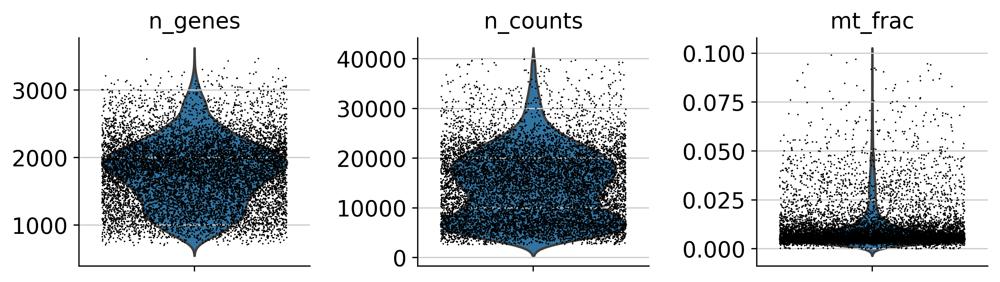

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


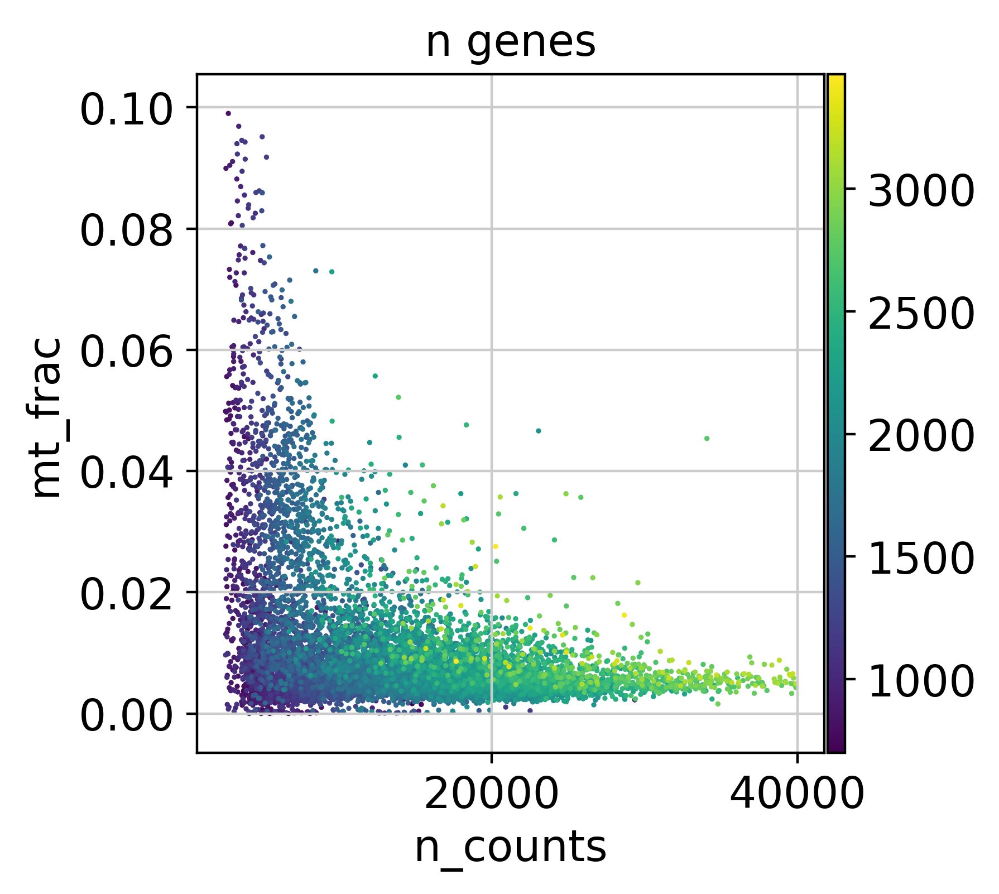

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


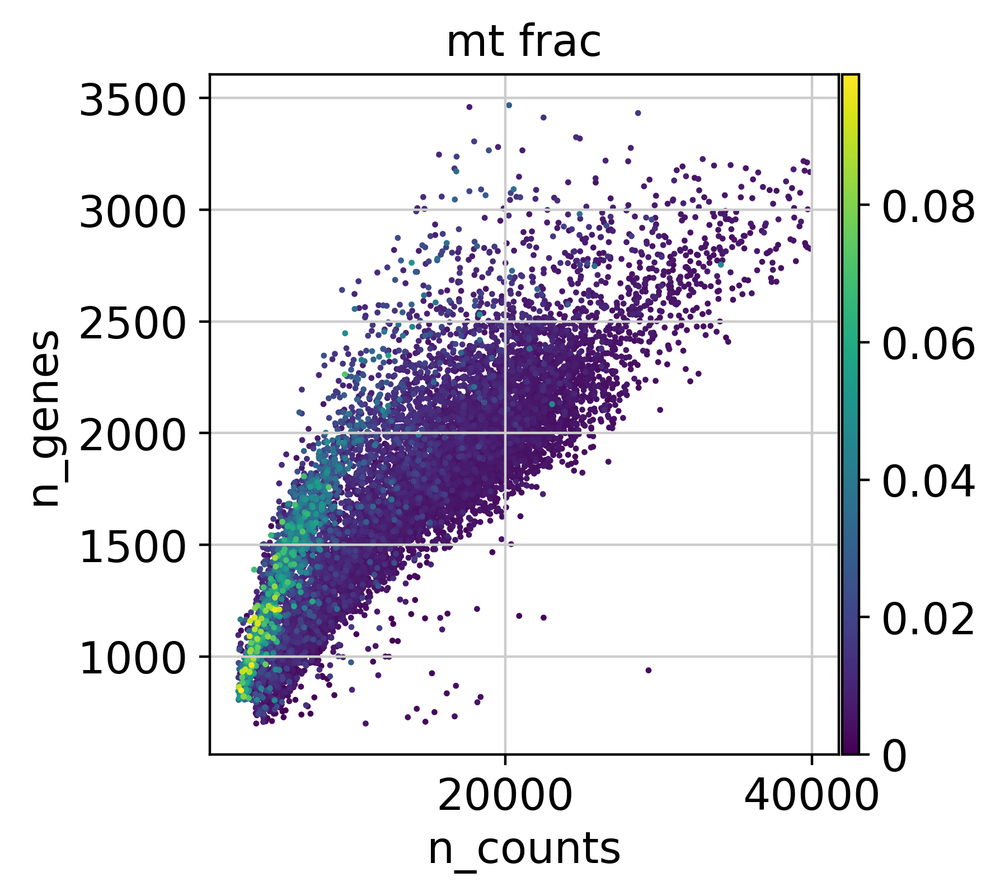

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


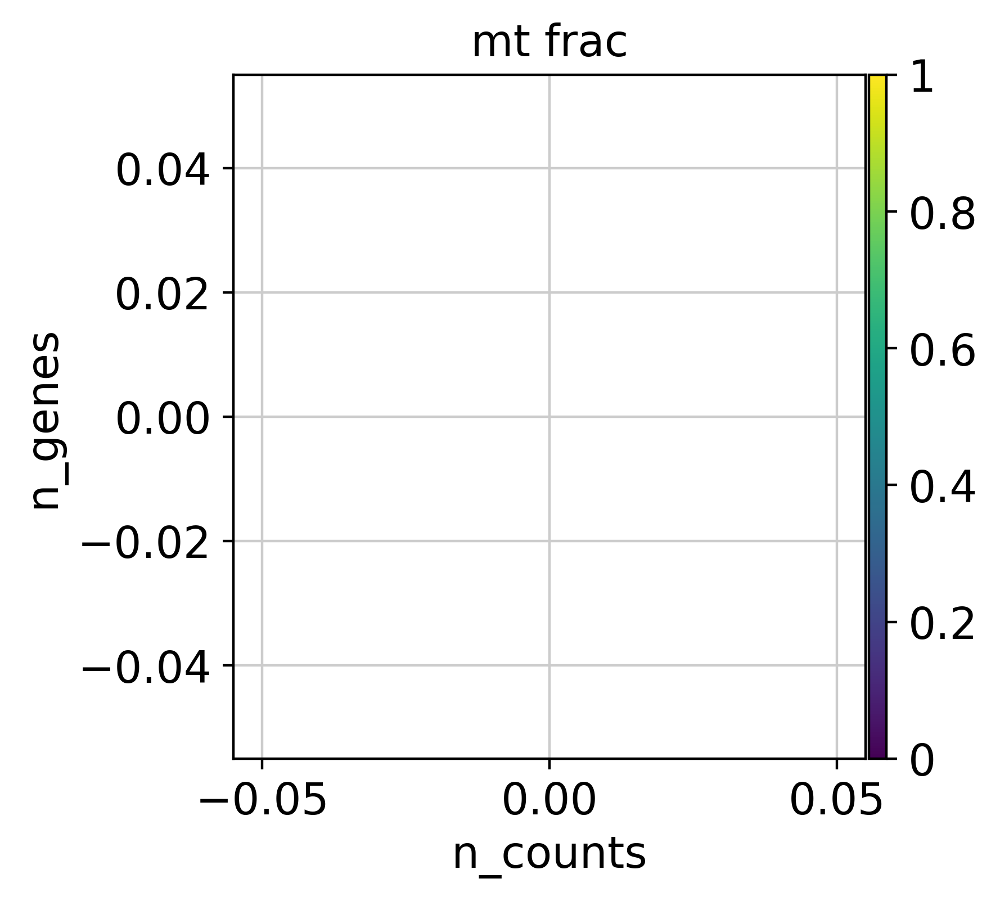

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


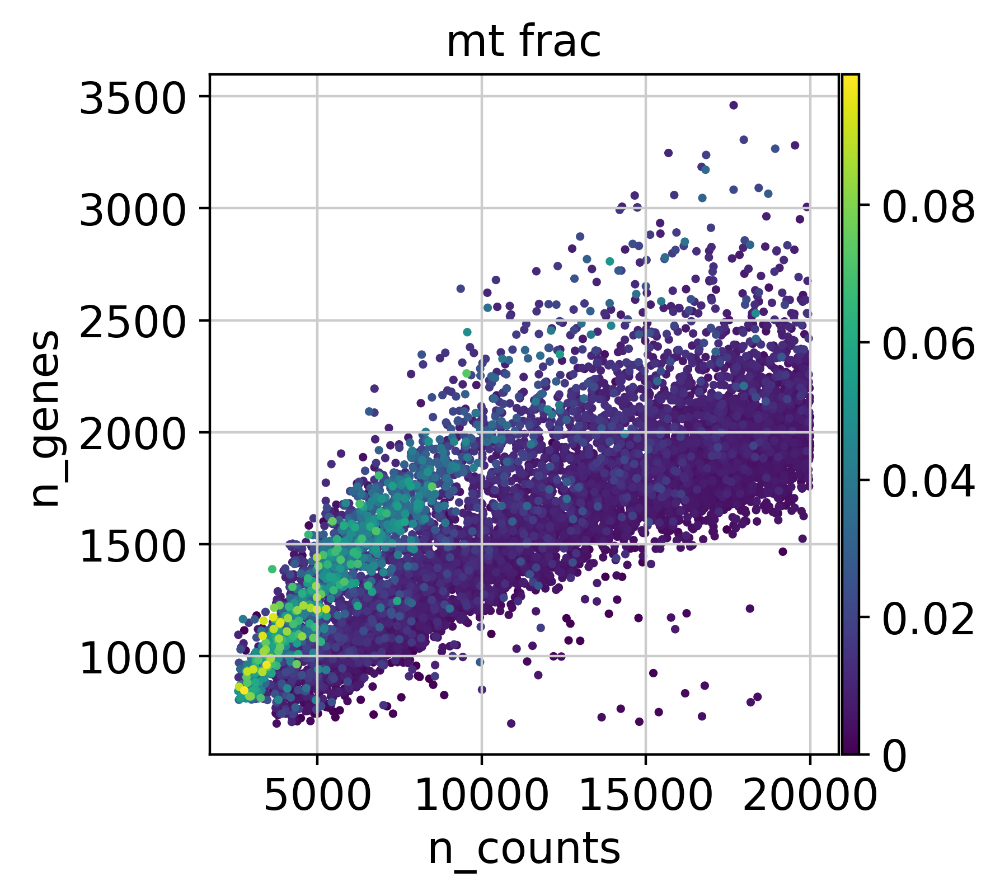

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:311: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  x_arr = adata._get_obs_array(x, use_raw=use_raw, layer=layers[0])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/scanpy/plotting/_anndata.py:312: DeprecationWarning: Use obs_vector instead of _get_obs_array, _get_obs_array will be removed in the future.
  y_arr = adata._get_obs_array(y, use_raw=use_raw, layer=layers[1])
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/anndata/base.py:1618: FutureWarning: In a future version of AnnData, access to `.X` by passing `layer='X'` will be removed. Instead pass `layer=None`.
  FutureWarning


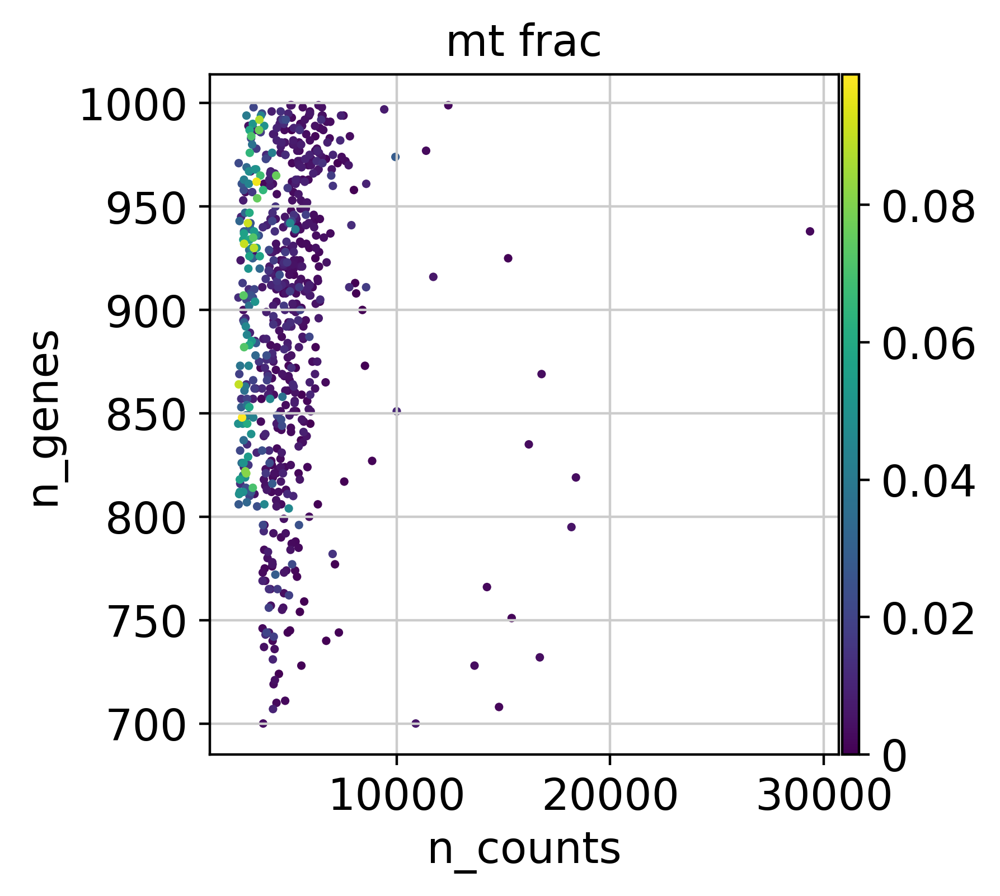

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  alternative="'density'", removal="3.1")


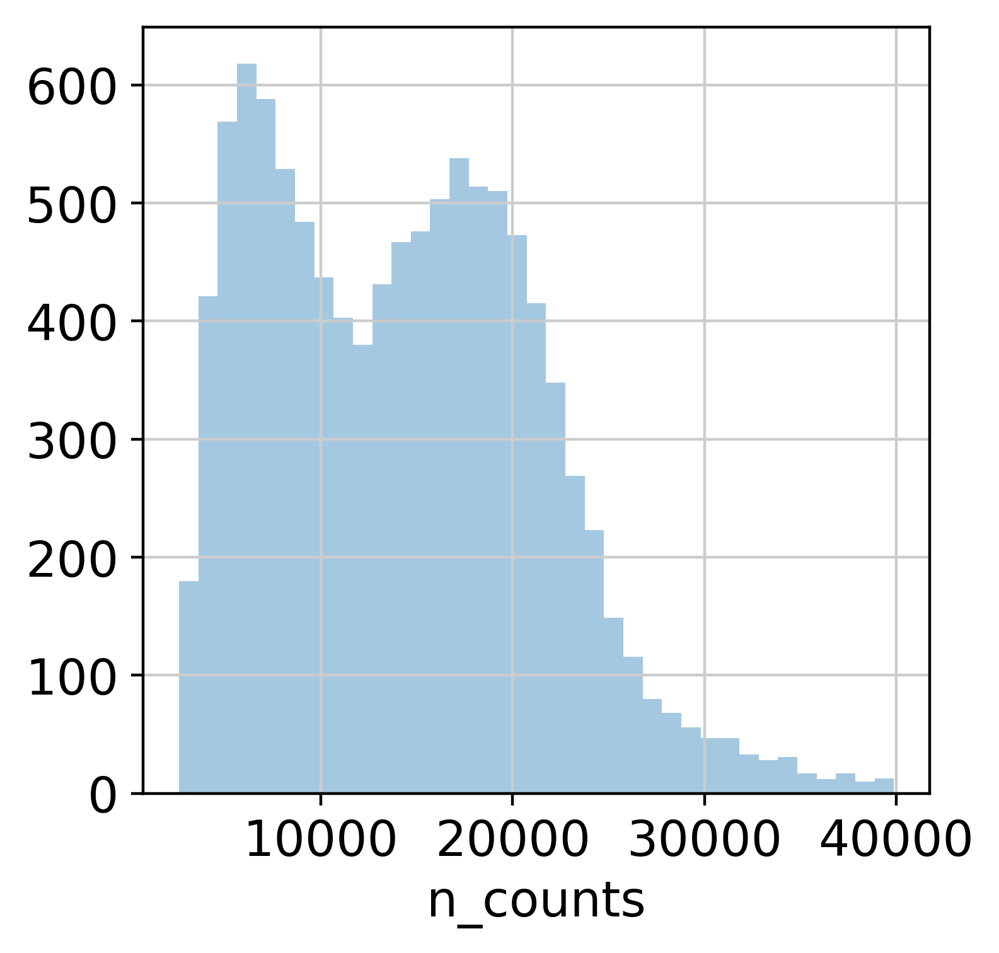

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/seaborn/distributions.py:195: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


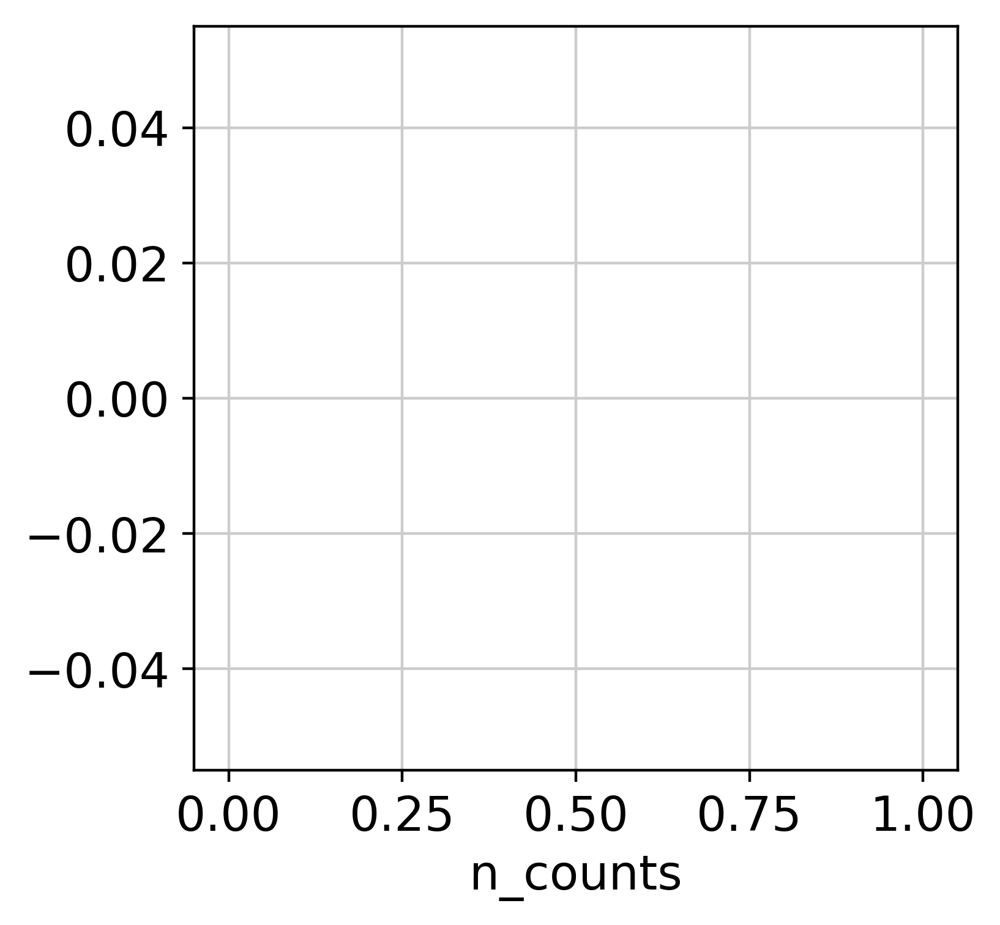

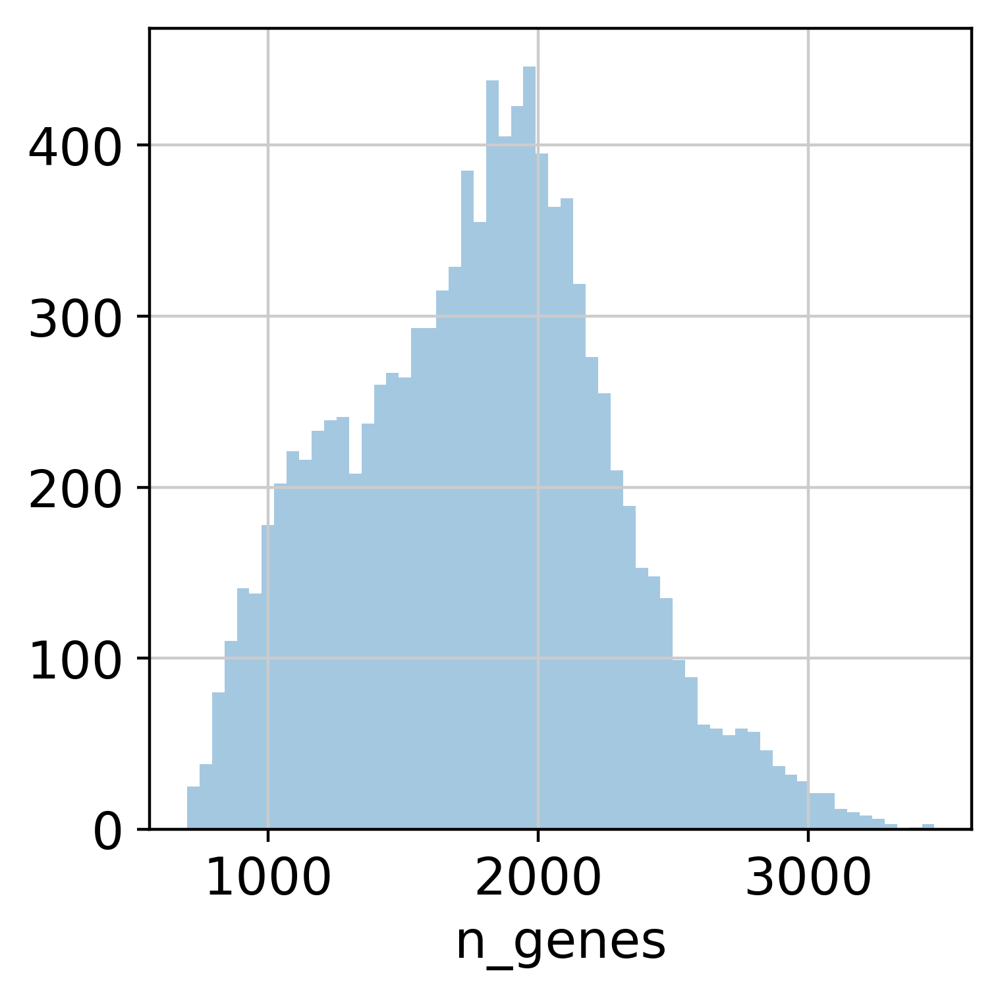

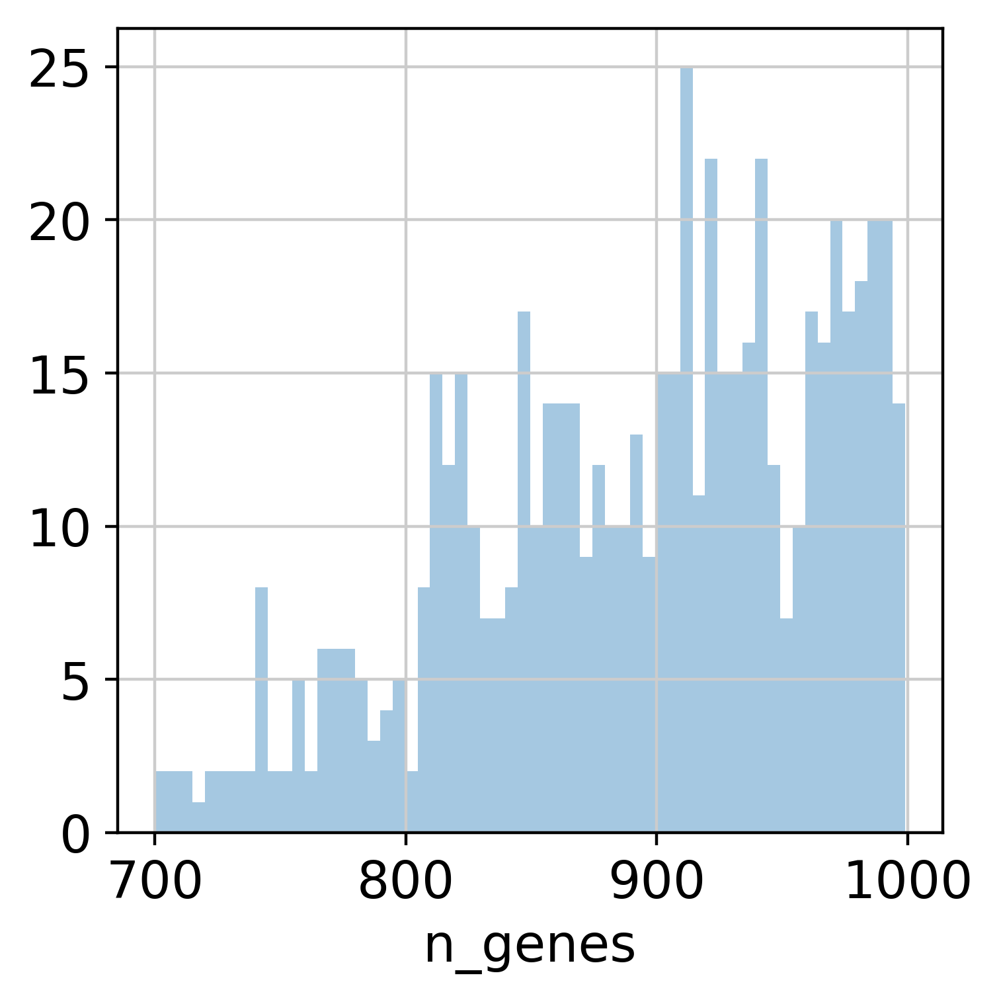

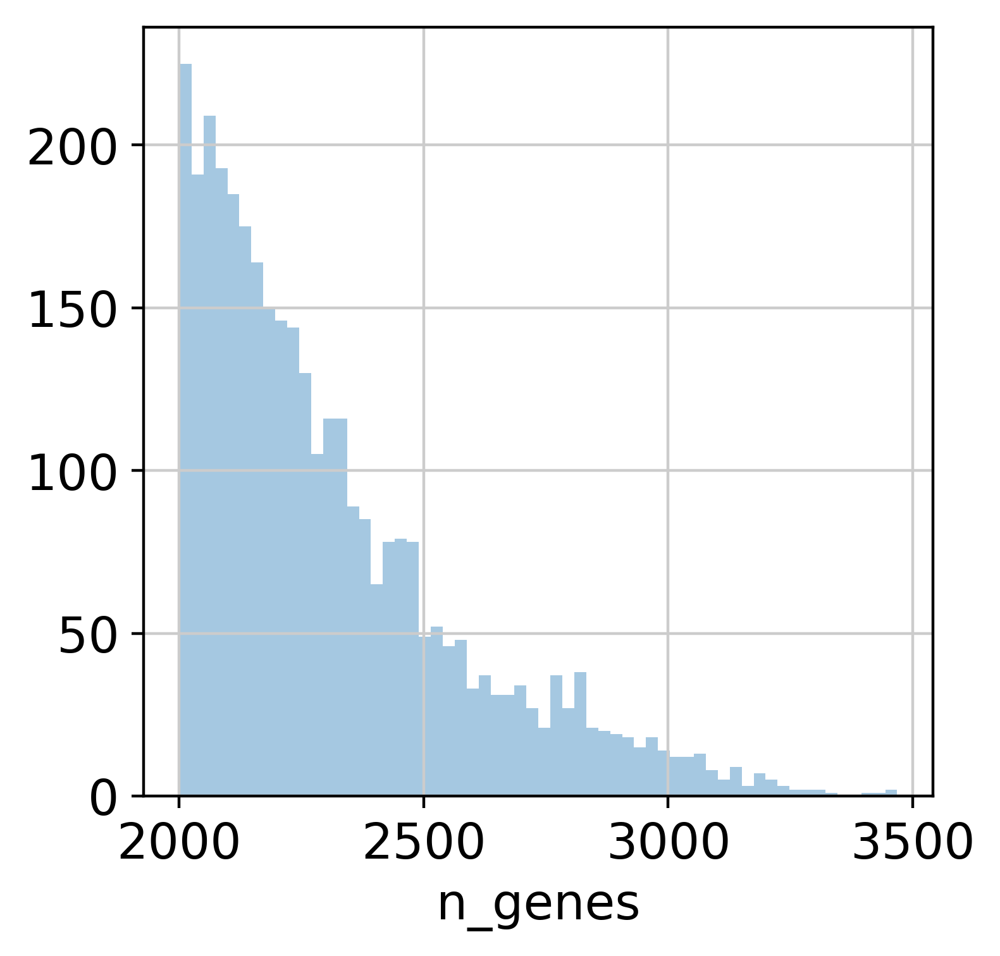

In [6]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'mt_frac'], jitter=0.4, multi_panel=True)
sc.pl.scatter(adata, x='n_counts', y='mt_frac', color = 'n_genes')

sc.pl.scatter(adata, 'n_counts', 'n_genes', color='mt_frac', size=15)
sc.pl.scatter(adata[adata.obs['n_counts']>40000], 'n_counts', 'n_genes', color='mt_frac', size = 30)
sc.pl.scatter(adata[adata.obs['n_counts']<20000], 'n_counts', 'n_genes', color='mt_frac', size = 30)
sc.pl.scatter(adata[adata.obs['n_genes']<1000], 'n_counts', 'n_genes', color='mt_frac',size=30)

p1 = sb.distplot(adata.obs['n_counts'], kde=False)
plt.show()
p2 = sb.distplot(adata.obs['n_counts'][adata.obs['n_counts']>40000], kde=False, bins=60)
plt.show()

p3 = sb.distplot(adata.obs['n_genes'], kde=False, bins=60)
plt.show()
p4 = sb.distplot(adata.obs['n_genes'][adata.obs['n_genes']<1000], kde=False, bins=60)
plt.show()
p5 = sb.distplot(adata.obs['n_genes'][adata.obs['n_genes']>2000], kde=False, bins=60)
plt.show()

In [7]:
sc.pp.filter_cells(adata, min_genes = 800)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))
adata.shape

Number of cells after gene filter: 10431


(10431, 27599)

In [9]:
# np.mean(adata.obs['n_counts'])
# np.median(adata.obs['n_genes'])

In [12]:
# Filter genes
print('Total number of genes: {:d}'.format(adata.n_vars))
sc.pp.filter_genes(adata, min_cells=25) # filter genes not expressed in atleast 25 cells
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 27599
Number of genes after cell filter: 14645


Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 38.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 0.3%
Elapsed time: 26.5 seconds


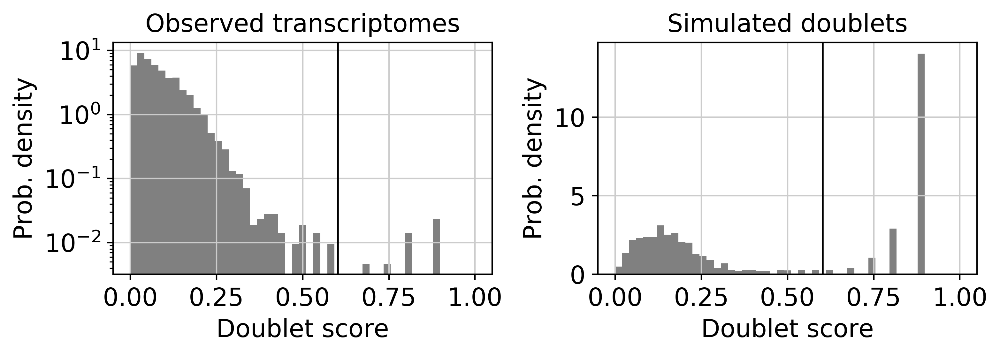

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py (457)

File "../../../anaconda3/lib/python3.6/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee type: recursive(type(CPUDispatcher(<function make_

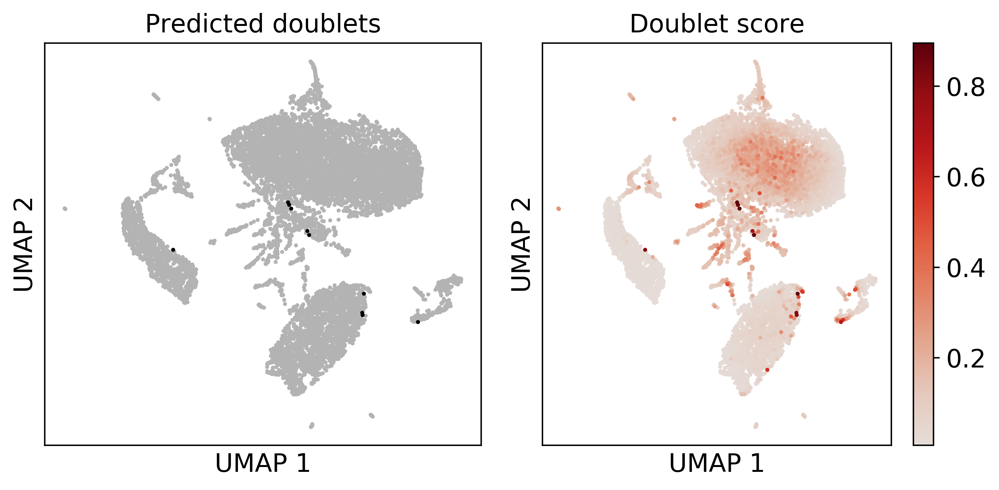

In [13]:
# Re-computing doublet scores for plotting
scrub = scr.Scrublet(adata.X)
doublet_scores, predicted_doublets = scrub.scrub_doublets()
# scrub.call_doublets(threshold=0.45)
scrub.plot_histogram()
plt.show()
scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.4))
scrub.plot_embedding('UMAP', order_points=True);
plt.show()

adata.obs['doublet_scores'] = doublet_scores

# Normalization
# Calculate highly variable genes

In [16]:
# Save a copy of the raw, filtered data in a 'counts' layer
# Log-transform data and perform a total counts per cell normalization
adata.layers['counts'] = adata.X
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)
adata.raw = adata

Number of highly variable genes: 3999


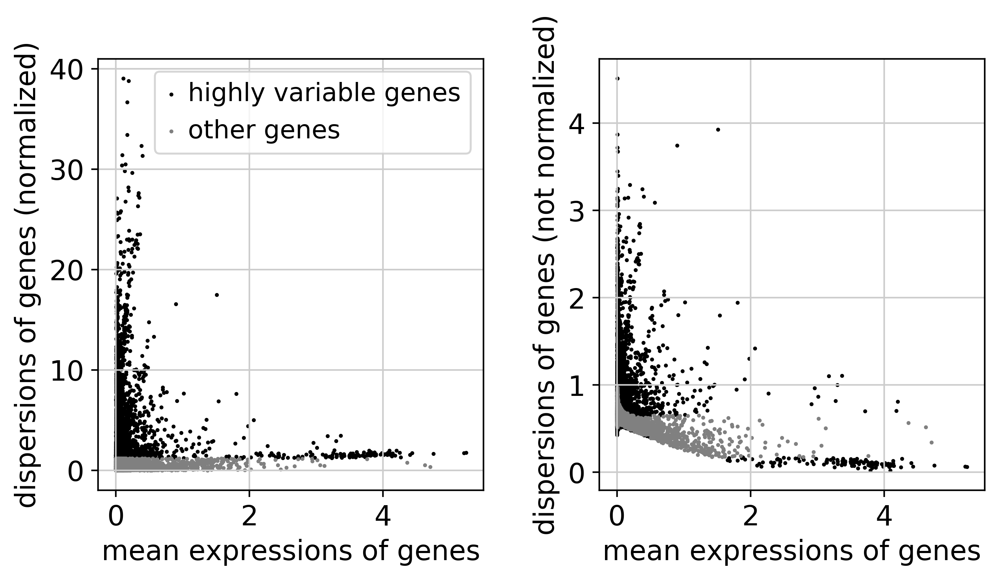

(14645, 4)


In [18]:
disp_filter = sc.pp.filter_genes_dispersion(adata.X, flavor='cell_ranger', n_top_genes=4000, log=False)

print('Number of highly variable genes: {:d}'.format(adata[:, disp_filter['gene_subset']].n_vars))
adata.var['highly_variable_genes'] = disp_filter['gene_subset']
adata.var['expression_mean'] = disp_filter['means']
adata.var['dispersion'] = disp_filter['dispersions']
sc.pl.filter_genes_dispersion(disp_filter)
print(adata.var.shape)

In [20]:
# Regress out technical effects due to count depths
sc.pp.regress_out(adata, ['n_counts'])

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


# Calculate embeddings

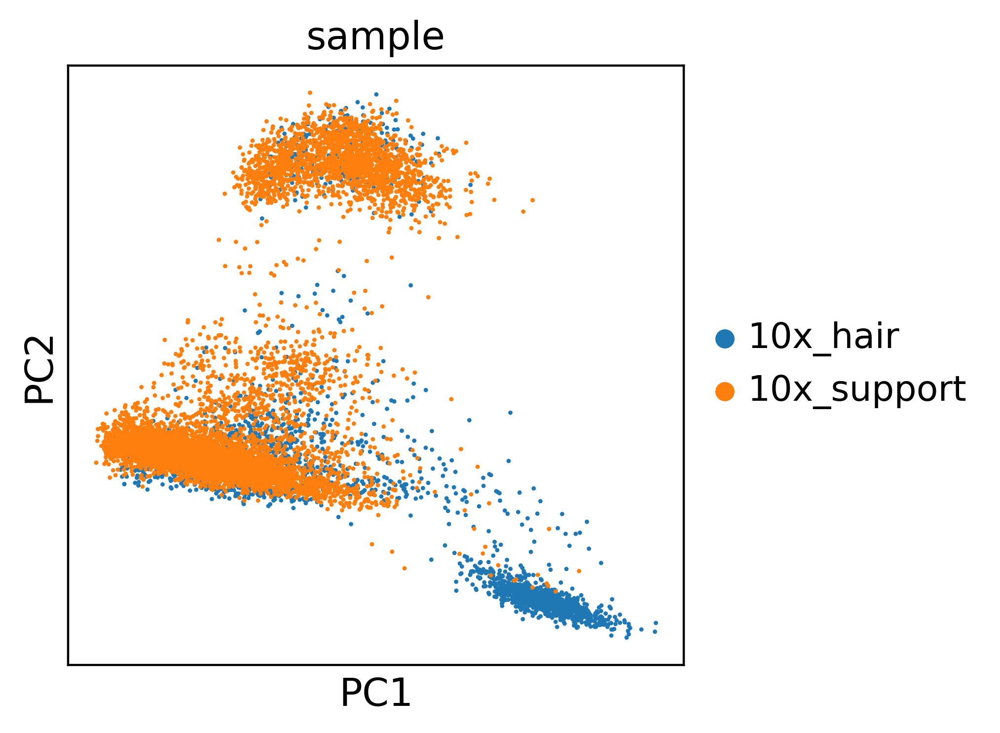

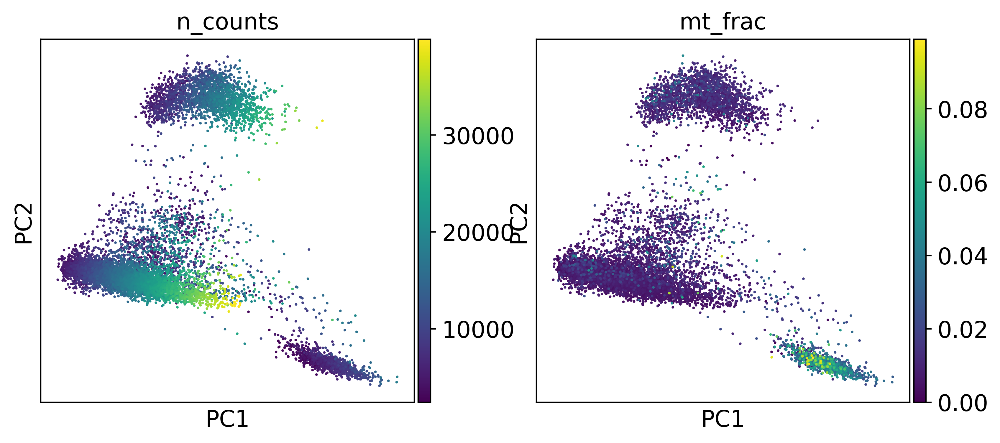

In [21]:
sc.tl.pca(adata, svd_solver = "arpack")
sc.pl.pca_scatter(adata, color = ['sample'], size = 10)
sc.pl.pca_scatter(adata, color = ['n_counts','mt_frac'], size = 10)

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/numba/compiler.py:588: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/lib/python3.6/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/umap/umap_.py:349: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../../anaconda3/lib/python3.6/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is Non

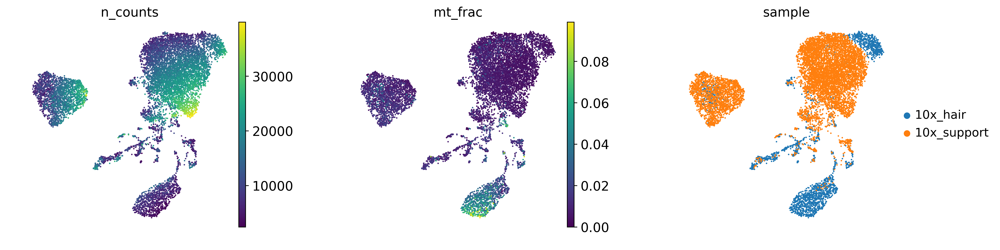

In [24]:
sc.pp.neighbors(adata, n_neighbors=25)
sc.tl.umap(adata)
sc.pl.umap(adata, color = ['n_counts','mt_frac','sample'], size=10, wspace = 0.4, frameon = False)

### Plotting the expression of selected markers

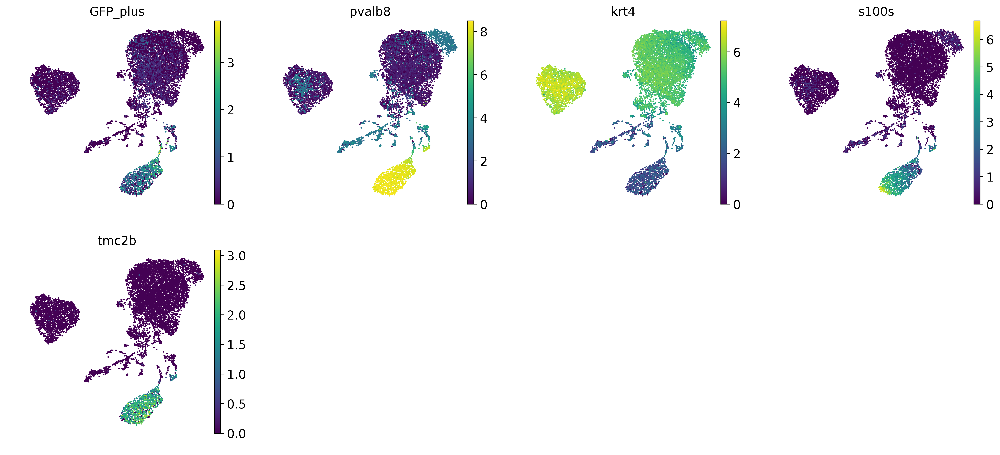

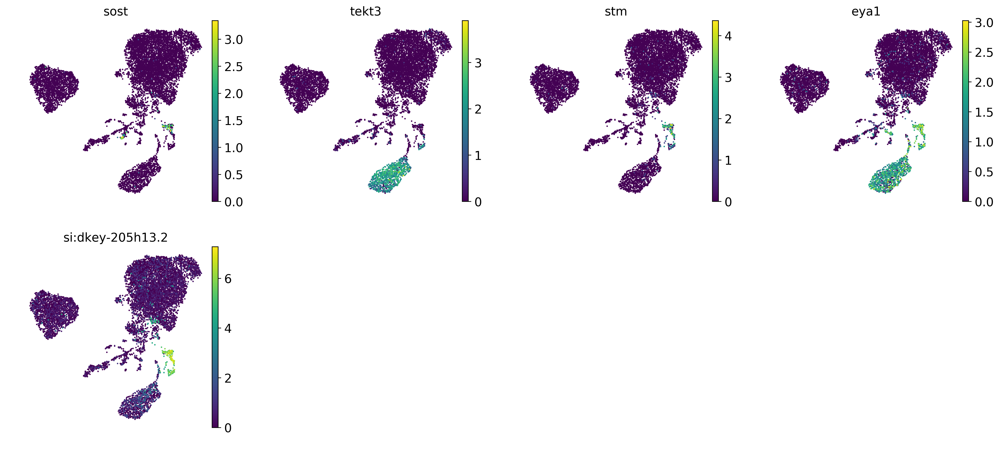

In [25]:
sc.pl.umap(adata, color = ['GFP_plus','pvalb8','krt4','s100s','tmc2b'], frameon = False)
sc.pl.umap(adata, color = ['sost','tekt3','stm','eya1','si:dkey-205h13.2'], frameon = False)

# Supplementary figure 1K

saving figure to file ./figures/umap_on full data.pdf


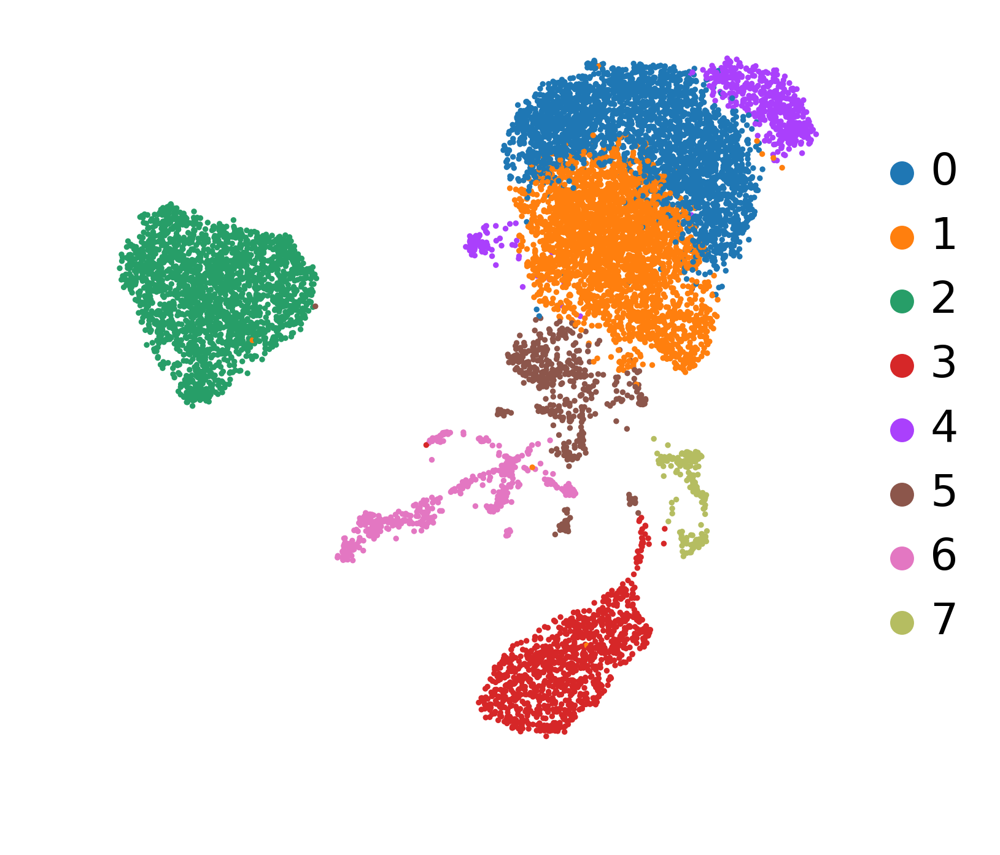

In [26]:
sc.tl.louvain(adata, resolution=0.4)
sc.pl.umap(adata, color = 'louvain', frameon = False, title = '', save = '_on full data.pdf')

# Supplementary figure 1L

saving figure to file ./figures/stacked_violin_markers_cluster_exclusion.pdf


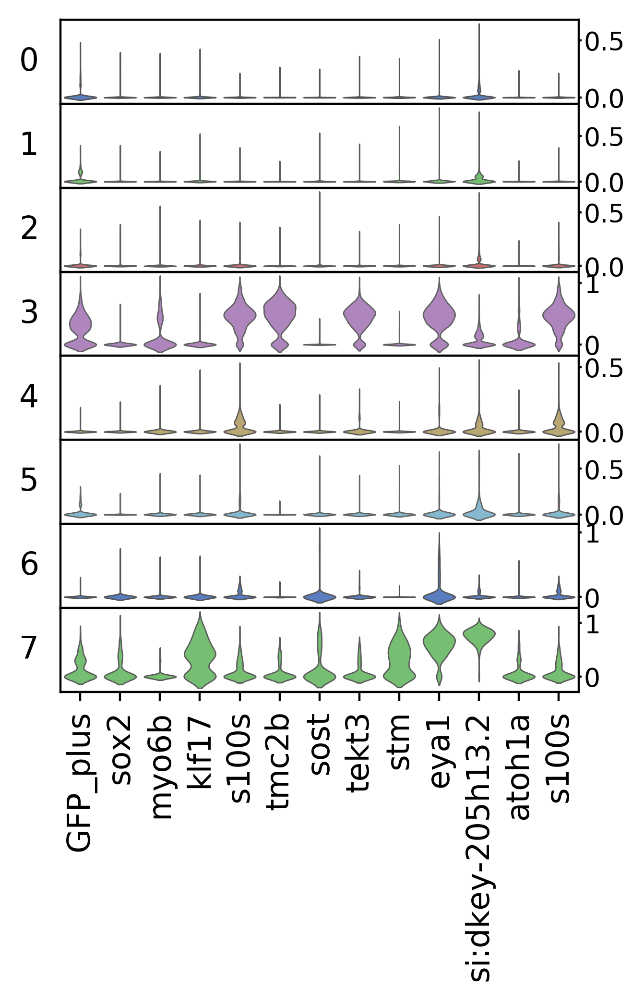

In [27]:
geneset = ['GFP_plus','sox2','myo6b','klf17','s100s','tmc2b','sost','tekt3','stm','eya1','si:dkey-205h13.2','atoh1a','s100s']
sc.pl.stacked_violin(adata, var_names=geneset, groupby='louvain', jitter = False, striplot = True, standard_scale='var', save = '_markers_cluster_exclusion.pdf')

In [28]:
group='louvain'
subgroup= ['3','7']
# Subset the cells
sub_cells = np.isin(adata.obs[group], [subgroup])
adata_sub=adata[sub_cells].copy()
adata_sub

AnnData object with n_obs × n_vars = 1167 × 14645 
    obs: 'batch', 'log_counts', 'mt_frac', 'n_counts', 'n_genes', 'sample', 'doublet_scores', 'louvain'
    var: 'n_cells', 'highly_variable_genes', 'expression_mean', 'dispersion'
    uns: 'pca', 'sample_colors', 'neighbors', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'

In [30]:
sc.pp.neighbors(adata_sub, n_neighbors=15) # 15
sc.tl.umap(adata_sub)

/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/umap/umap_.py:349: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../../anaconda3/lib/python3.6/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is None or knn_dists is None:
        knn_indices, knn_dists, _ = nearest_neighbors(
        ^

  @numba.jit()
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/numba/compiler.py:725: NumbaWarning: Function "fuzzy_simplicial_set" was compiled in object mode without forceobj=True.

File "../../../anaconda3/lib/python3.6/site-packages/umap/umap_.py", line 350:
@numba.jit()
def fuzzy_simplicial_set(
^

  self.func_ir.loc))
/home/icb/subarna.palit/anaconda3/lib/python3.6/site-packages/numba/compiler.py:734: NumbaDepr

In [1]:
adata_sub.obs['sample'] = adata_sub.obs['sample'].replace({'10x_hair': 'hair cells sample', '10x_support': 'support cells sample'})
adata_sub.obs['sample']

# Main figure 2G

... storing 'sample' as categorical


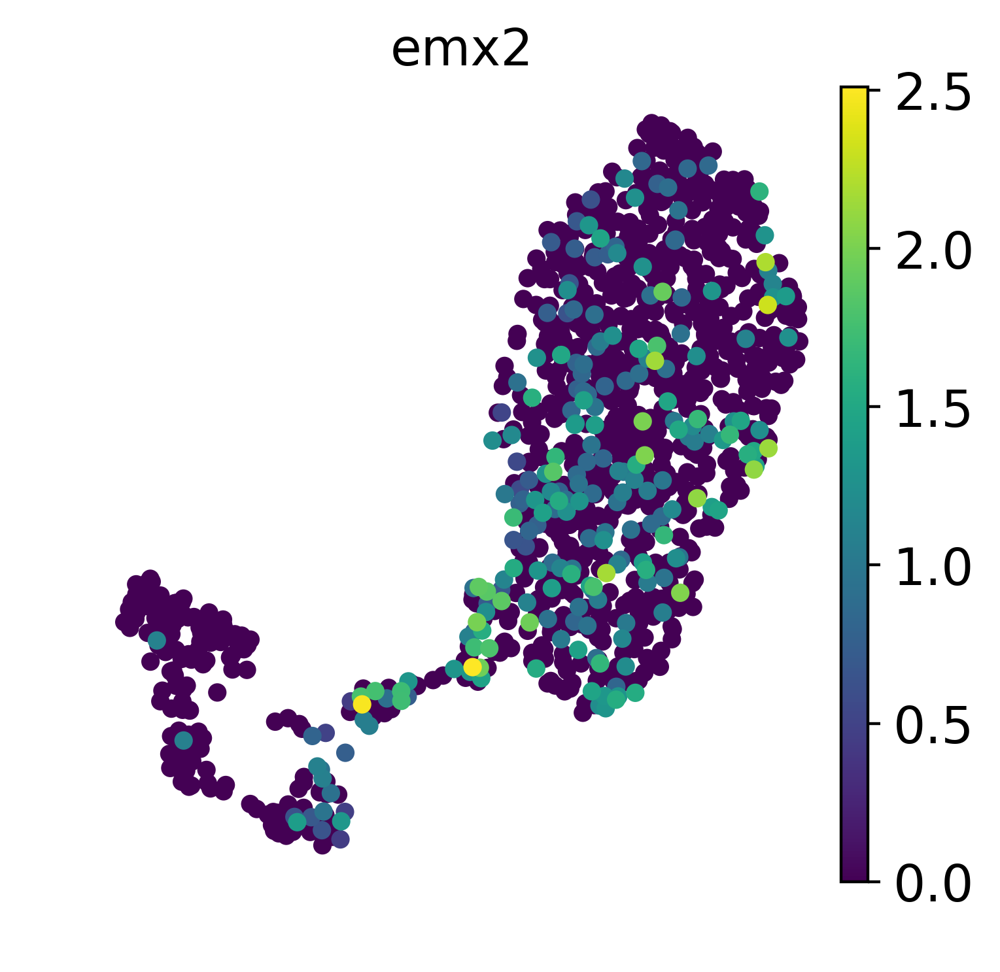

saving figure to file ./figures/umap_QC figures.pdf


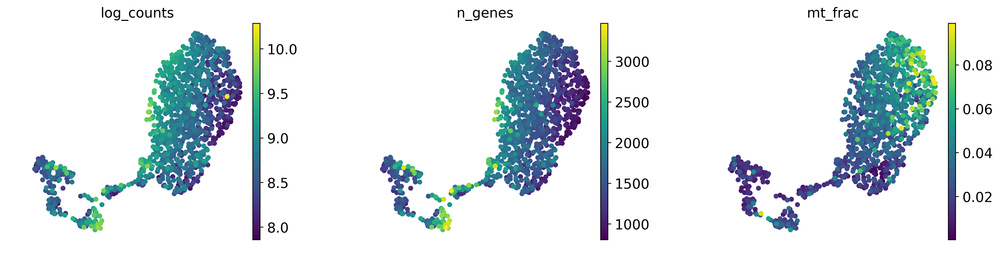

saving figure to file ./figures/umap_sample anno.pdf


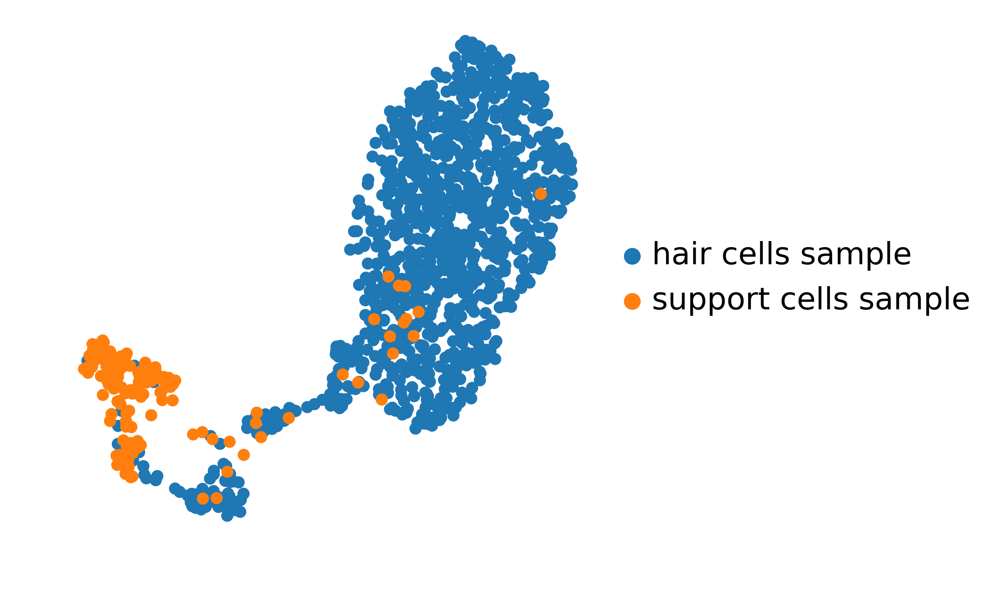

In [32]:
sc.pl.umap(adata_sub, color = ['emx2'], wspace = 0.4, frameon = False)
sc.pl.umap(adata_sub, color = ['log_counts','n_genes','mt_frac'], wspace = 0.4, frameon = False, save = '_QC figures.pdf')
sc.pl.umap(adata_sub, color = ['sample'], wspace = 0.4, frameon = False, title = '', save = '_sample anno.pdf')

... storing 'emx2_exp' as categorical
... storing 'emx2_expr' as categorical


saving figure to file ./figures/umap_merged_hair_supp_s100t.pdf


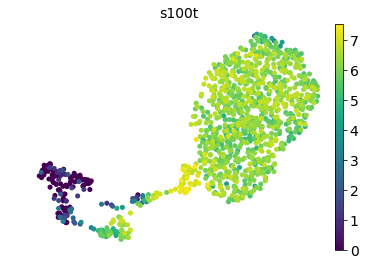

saving figure to file ./figures/umap_merged_hair_supp_s100s.pdf


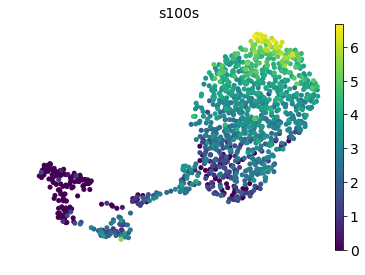

saving figure to file ./figures/umap_merged_hair_supp_pvalb8.pdf


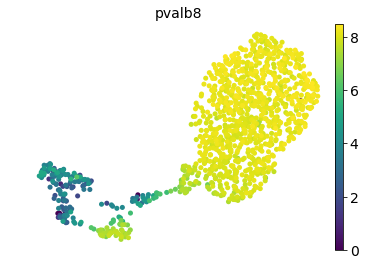

saving figure to file ./figures/umap_merged_hair_supp_tmc2b.pdf


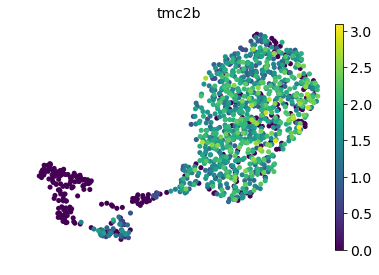

In [82]:
geneset = ['s100t', 's100s', 'pvalb8', 'tmc2b']
for each in geneset:
    sc.pl.umap(adata, color = each, frameon = False, save = '_merged_hair_supp_'+each+'.pdf')

In [ ]:
geneset = ['emx2', 'atoh1a', 'myo6b', 'tekt3', 'stm', 'sost', 'klf17', 'si:dkey-205h13.2', 'notch1a','notch1b','dld']
for each in geneset:
    sc.pl.umap(adata, color = each, frameon = False, save = '_merged_hair_supp_'+each+'.pdf')

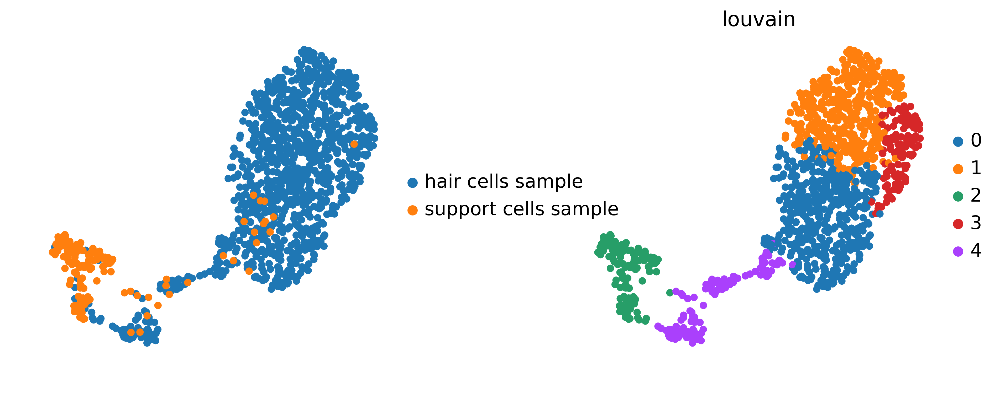

In [34]:
sc.tl.louvain(adata_sub, resolution=0.55)
sc.pl.umap(adata_sub, color = ['sample','louvain'], wspace = 0.4, frameon = False, title = '')

In [36]:
adata_sub.rename_categories('louvain', ['young HCs', 'mature HCs', 'support cells', 'damaged HCs', 'HC progenitors'])

# Supplementary figure 2B

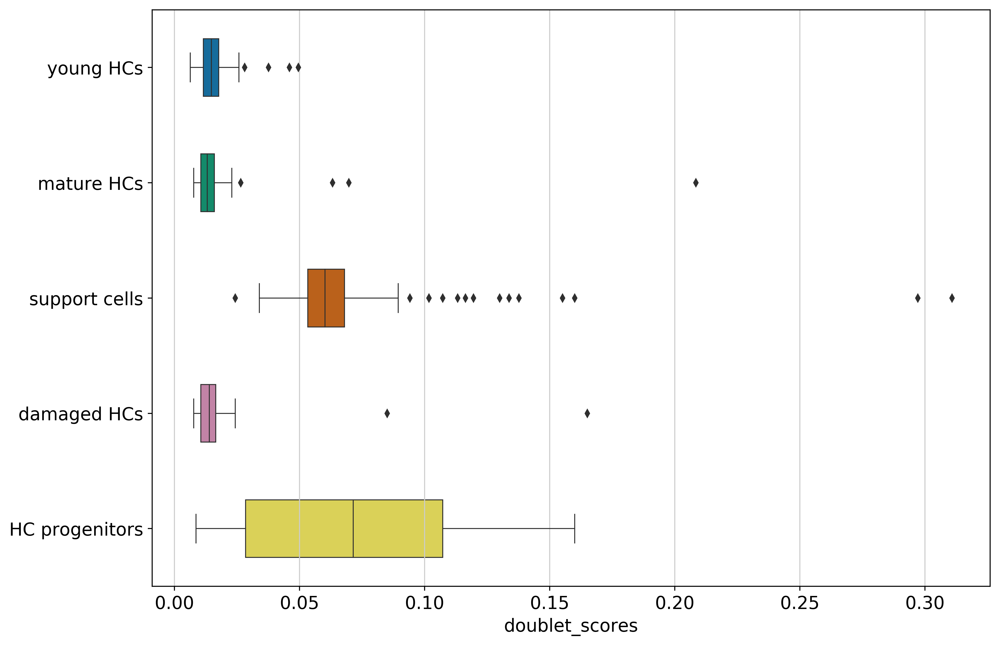

In [37]:
from matplotlib import rcParams
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27

sb.boxplot(x="doublet_scores", y="louvain", data=adata_sub.obs, palette="colorblind", width=0.5, fliersize=4, linewidth=.75)
# plt.xlabel('')
plt.ylabel('')
# plt.show()
# plt.tight_layout()
plt.savefig('figures/doublet_scores.pdf', dpi = 100)

# Main figure 2C

saving figure to file ./figures/umap_annotated.pdf


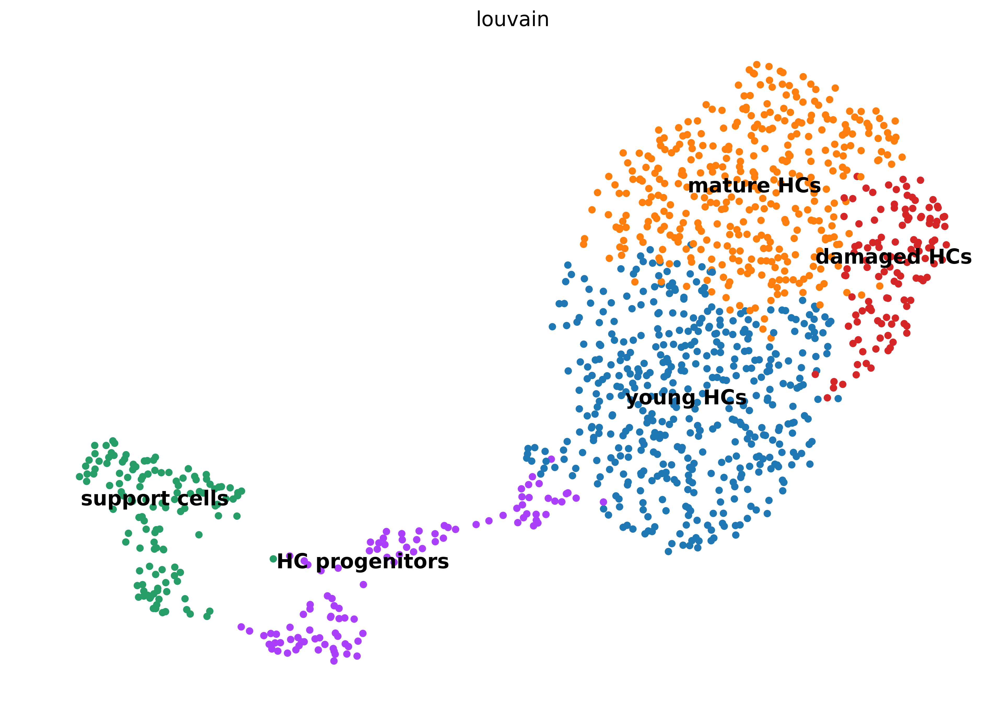

In [38]:
sc.pl.umap(adata_sub, color = ['louvain'], wspace = 0.4, frameon = False, save = '_annotated.pdf', legend_loc = 'on data')

# Main figure 2D

In [ ]:
geneset = ['atoh1a','stm','myo6b','sost','tekt3','klf17','dld','s100s','tmc2b','s100t','pvalb8','si:dkey-205h13.2']
sc.pl.stacked_violin(adata_sub, var_names=geneset, groupby='louvain', jitter = False, striplot = True, standard_scale='var')

# Main figure 2B

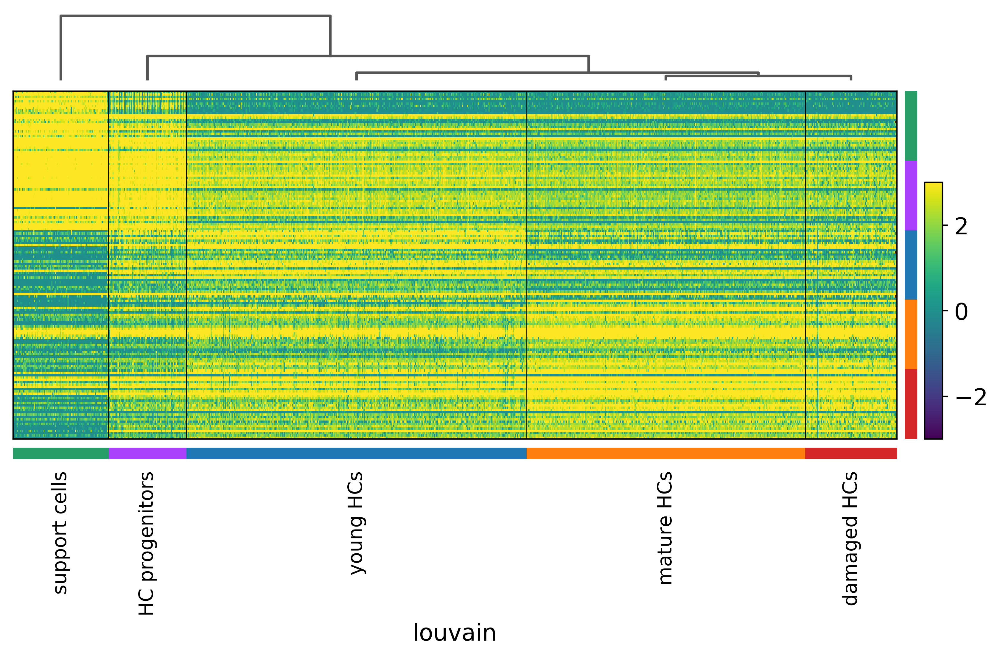

In [40]:
sc.pl.rank_genes_groups_heatmap(adata_sub, n_genes=30, use_raw=True, swap_axes=True,
                                vmin=-3, vmax=3)

# Supplementary figure 2A

saving figure to file ./figures/violin_QC_on_hair_supp_merged.pdf


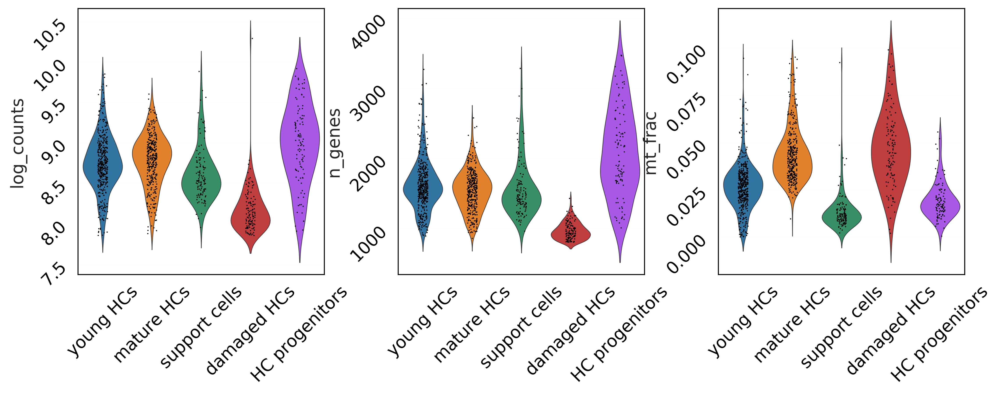

In [105]:
sc.pl.violin(adata_sub, keys=['log_counts','n_genes','mt_frac'], groupby='louvain', jitter = True, striplot = False, rotation = 45, wspace = 0.4, linewidth = 0.5, save = '_QC_on_hair_supp_merged.pdf')

# Main figure 3A

In [1]:
# Interpretation of differentially expressed genes in support and progenitor cells using gprofiler
import re
from gprofiler import GProfiler

df_n = df[[col for col in df.columns if re.match(r'.*_n$',col)]]
gp = GProfiler(return_dataframe=True, user_agent='g:GOSt')
for each in df_n.columns:
    DE_enrichment = gp.profile(organism='drerio', sources=['KEGG'], user_threshold=0.05, # zebrafish and KEGG pathways
                               significance_threshold_method='fdr', 
                               background=adata_sub.var_names.tolist(), 
                               query=list(df_n[each]))
    DE_enrich_results = DE_enrichment.set_index('native').sort_values('p_value').iloc[:,[2,5,7,10,1]]
    # pd.set_option("display.max_colwidth", 800)
    DE_enrich_results = DE_enrich_results.drop('KEGG:00000')
#     print(DE_enrich_results.iloc[:50,:])
    
    plot_enrich(DE_enrich_results, save = '_KEGG_'+each+'.pdf')

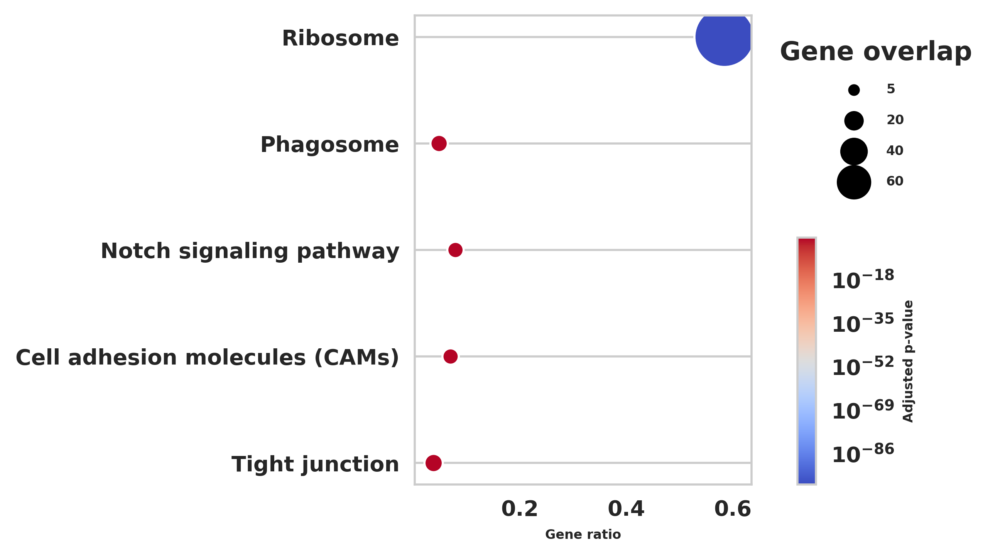

In [1]:
sc.tl.diffmap(adata_sub)

In [109]:
sc_mask = np.isin(adata_sub.obs['louvain'], 'support cells')
max_sc_id = np.argmin(adata_sub.obsm['X_diffmap'][sc_mask,2])
root_id = np.arange(len(sc_mask))[sc_mask][max_sc_id]
adata_sub.uns['iroot'] = root_id
print(adata_sub.uns['iroot'])
# Compute dpt
sc.tl.dpt(adata_sub)

1072


# Main figure 2E

saving figure to file ./figures/diffmap_1,2_root_cell.pdf


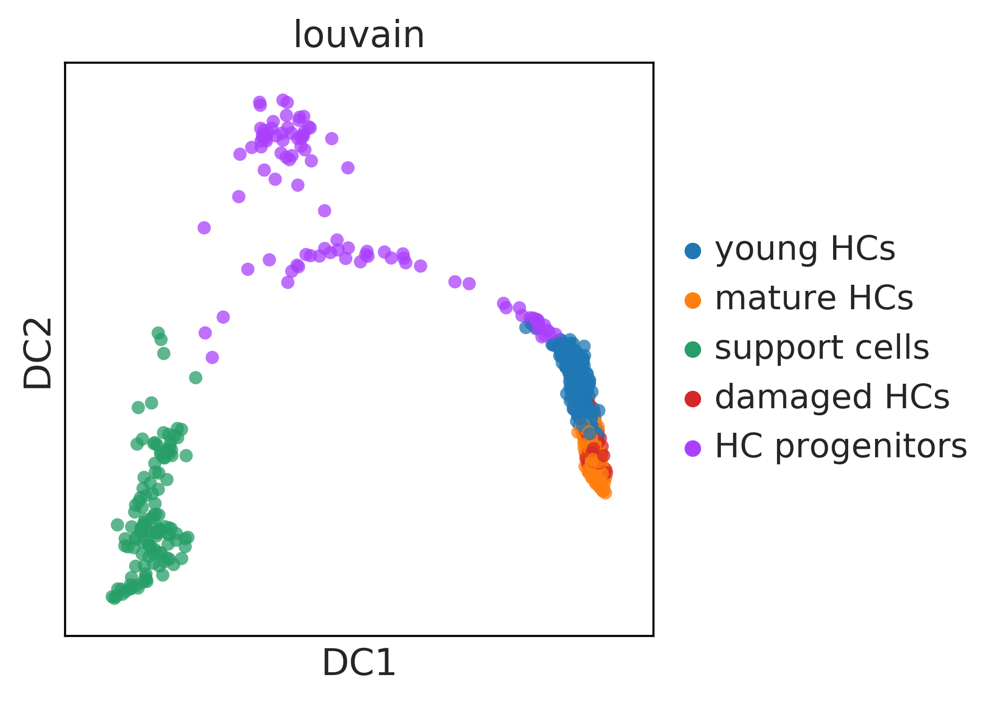

saving figure to file ./figures/diffmap_1,2_dpt.pdf


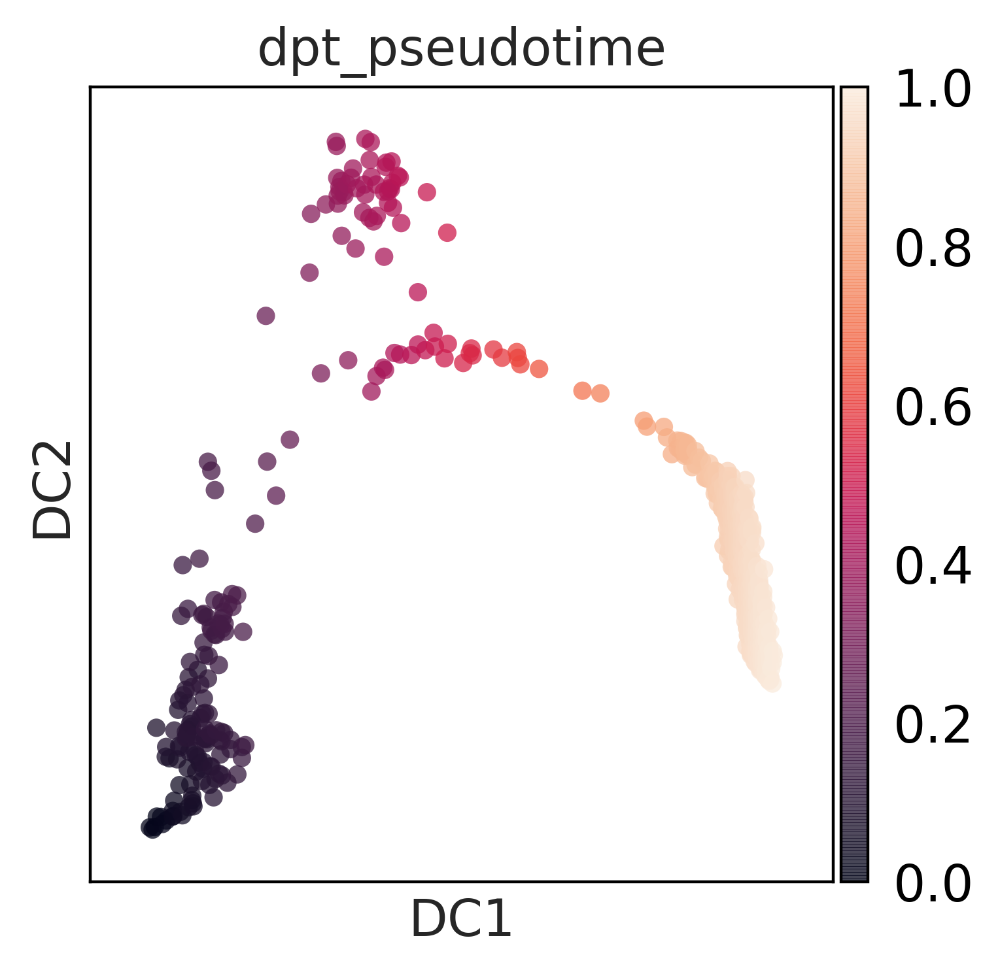

In [112]:
sc.pl.diffmap(adata_sub, components='1,2', color=['louvain'], frameon = True, alpha = 0.75, save = '_1,2_root_cell.pdf')
sc.pl.diffmap(adata_sub, components='1,2', color=['dpt_pseudotime'], frameon = True, alpha = 0.75, save = '_1,2_dpt.pdf')

# Main figure 3B

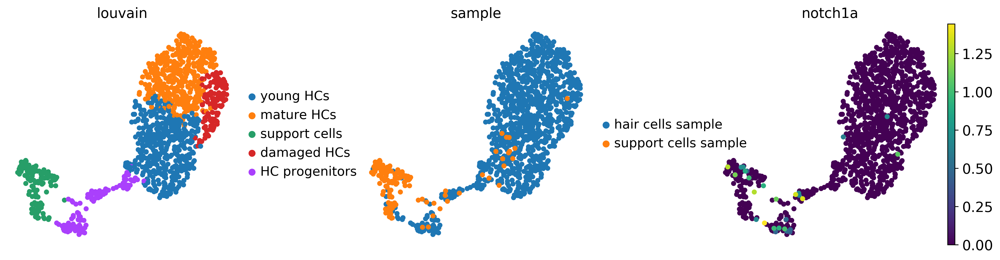

In [9]:
sc.set_figure_params(dpi = 150)
sc.pl.umap(adata, color = ['louvain','sample','notch1a'], wspace = 0.4, frameon = False)

# Main figure 2F

In [32]:
# paths = [('support', [2]),
#          ('hair progenitors', [4]),
#          ('hair young', [0]), ('hair mature', [1])]
paths = [('neuromast',[2,4,0,1])]
adata_sub.obs['distance'] = adata_sub.obs['dpt_pseudotime']
adata_sub.obs['clusters'] = adata_sub.obs['louvain']
adata_sub.uns['clusters_colors'] = adata_sub.uns['louvain_colors']

In [48]:
geneset = ['stm','atoh1a','myo6b','tekt3','pvalb8','emx2']
_, axs = plt.subplots(ncols=1, figsize=(6,3), gridspec_kw={'wspace': 0.005, 'left': 0.01})
plt.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    _, data = sc.pl.paga_path(
        adata_sub, path, geneset,
        show_node_names=False,
        # ax=axs[ipath],
        ytick_fontsize=8,
        left_margin=0.01,
        n_avg=90,
        annotations=['distance'],
        show_yticks=True if ipath==0 else False,
        show_colorbar=False,
        color_map='Blues',
        groups_key='clusters',
        color_maps_annotations={'distance': 'viridis'},
        title='{} path'.format(descr),
        return_data=True,
        show=False, save = 'neuromast_path.pdf', normalize_to_zero_one=True)
plt.show()

saving figure to file ./figures/paga_pathneuromast_path.pdf
